<a href="https://colab.research.google.com/github/moienr/LST-SigleChannel-SplitWindow/blob/main/Sebal_Rn_Level1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Calculating Surface Radiation Balance Equation for Rn - Landsat C2 Level 1

**Class of Remote Sensing of Water, Soil and Vegetation - `Dr. Hamzeh`**

by: `Moien Rangzan`
moienrangzan@gmail.com

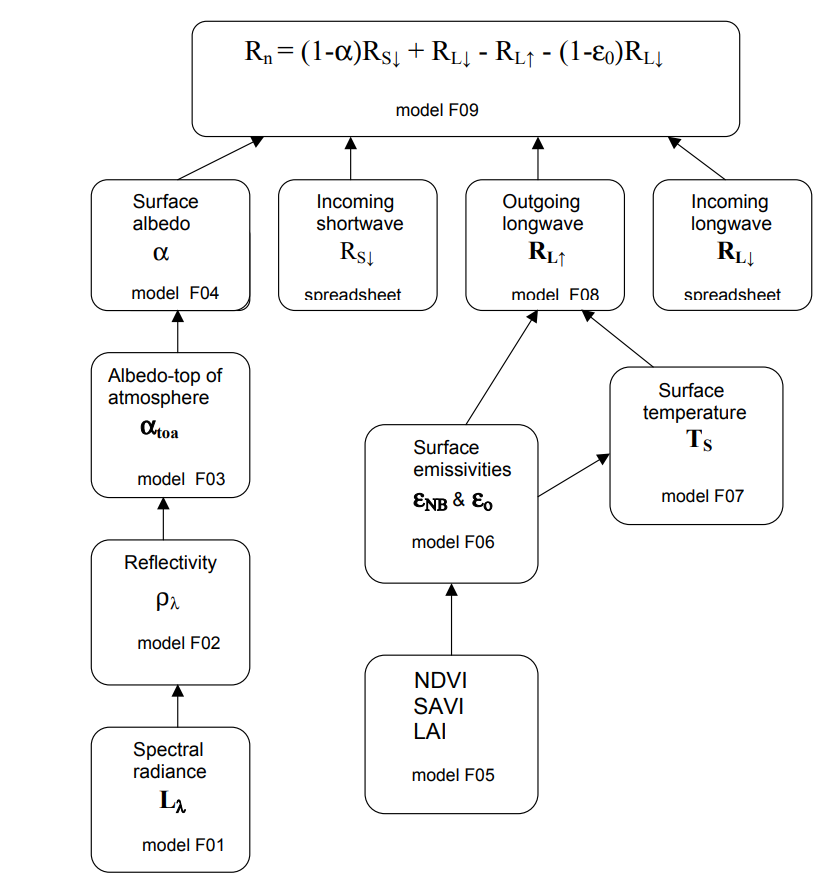

# Calculating ALbedo for C2 Level 1

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install rasterio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

import plotly.express as px # for interactive plots and inspecting the pixel values.

import gdal
import rasterio

In [ ]:
if not (os.path.exists("/content/subset/")):
  !unzip '/content/drive/MyDrive/Colab Notebooks/SEBAL/subset.zip'
else:
  print('aleady unziped')

aleady unziped


## Calculating Albedo for Landsat8 C2L1

### importig the bands

In [ ]:
l1b2 = plt.imread('/content/subset/L1/LC08_L1TP_B2_cliped.tif')
l1b3 = plt.imread('/content/subset/L1/LC08_L1TP_B3_cliped.tif')
l1b4 = plt.imread('/content/subset/L1/LC08_L1TP_B4_cliped.tif')
l1b5 = plt.imread('/content/subset/L1/LC08_L1TP_B5_cliped.tif')
l1b6 = plt.imread('/content/subset/L1/LC08_L1TP_B6_cliped.tif')
l1b7 = plt.imread('/content/subset/L1/LC08_L1TP_B7_cliped.tif')

l1b10 = plt.imread('/content/subset/L1/LC08_L1TP_B10_cliped.tif')
l1b11 = plt.imread('/content/subset/L1/LC08_L1TP_B11_cliped.tif')

dem = rasterio.open('/content/drive/MyDrive/Colab Notebooks/SEBAL/aster_dem_subset.tif')


In [ ]:
dem =dem.read()
dem = dem[0]


In [ ]:
dem.shape

(327, 331)

In [ ]:
l1b2

array([[7799, 7869, 7886, ..., 8307, 8275, 8251],
       [7808, 8013, 8050, ..., 8313, 8250, 8274],
       [7975, 8232, 8242, ..., 8311, 8255, 8256],
       ...,
       [7832, 8059, 8169, ..., 7822, 7859, 7877],
       [8231, 8183, 8194, ..., 7857, 7881, 7752],
       [8232, 8169, 8183, ..., 7849, 7963, 7833]], dtype=uint16)

## Histogram Equalization


histogram stratching = https://docs.opencv.org/4.x/d5/daf/tutorial_py_histogram_equalization.html

https://github.com/computervisionpro/yt/blob/main/clahe/tutorial17.ipynb

unfortunalty this CLAHE stretching does not work on multi band images so should be appllied on each band separeaately - which gives wrong results since the contrast between each band will be lost and the images tends to be gray.
what we need to do is: we need to transform the image into HSV color space
and stretch the V (value - intesity) and leave the rest. this is how we get a good stretch

I found this wierd thing about `cv.COLOR_HSV2RGB` it actually returns `BGR` insead of `RGB` so after the `HSV2RGB` we need to reverse the bands.

**you dont notice it when doing showing RGB images but when I used Flase Color Composite, Trees turned out to be blue instead of red, which made undresentad this isue.**

In [ ]:
plt.rcParams['figure.figsize'] = [30,10]

In [ ]:
def stack_3_channel(r,g,b , clipLimit = 20 ,  tileGridSize=(16,16) ):


  # r = (r/np.max(r))*255
  # g = (g/np.max(g))*255
  # b = (b/np.max(b))*255

  img = np.stack([r,g,b], axis=2)
  img = cv.normalize(img, None, 0, 255, cv.NORM_MINMAX, dtype=cv.CV_8U)

  hsv_img = cv.cvtColor(img, cv.COLOR_BGR2HSV)
  h, s, v = hsv_img[:,:,0], hsv_img[:,:,1], hsv_img[:,:,2]



  clahe = cv.createCLAHE(clipLimit, tileGridSize)
  v = clahe.apply(v) #stretched histogram for showing the image with better contrast - its not ok to use it for scientific calculations

  hsv_img = np.dstack((h,s,v))

  # NOTE: HSV2RGB returns BGR instead of RGB
  bgr_stretched = cv.cvtColor(hsv_img, cv.COLOR_HSV2RGB)

  #reversing the bands back to RGB
  rgb_stretched = np.zeros(bgr_stretched.shape)
  rgb_stretched[:,:,0] = bgr_stretched[:,:,2]
  rgb_stretched[:,:,1] = bgr_stretched[:,:,1]
  rgb_stretched[:,:,2] = bgr_stretched[:,:,0]

  # if the valuse are float, plt will have problem showing them
  rgb_stretched = rgb_stretched.astype('uint8')

  return img , rgb_stretched

(310, 313, 3)
(310, 313, 3)


Text(0.5, 1.0, 'False Color Composite')

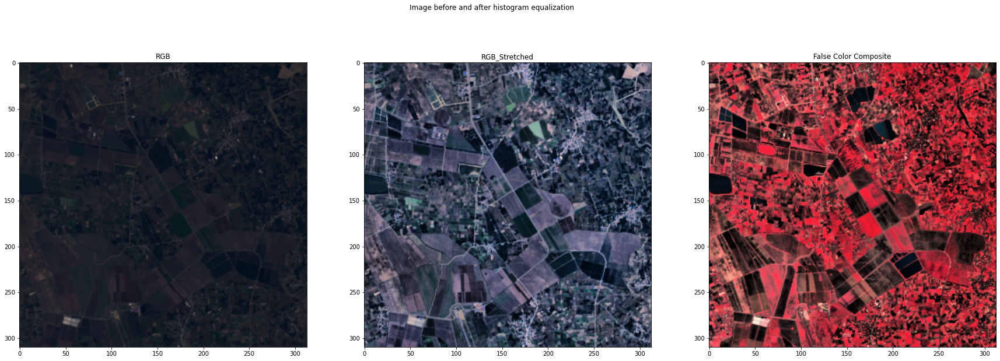

In [ ]:
rgb , stretched = stack_3_channel(l1b4,l1b3,l1b2,clipLimit = 10 ,  tileGridSize=(8,8) )
print(stretched.shape)

fcc , fcc_stretched = stack_3_channel(l1b5,l1b4,l1b3,clipLimit = 10 ,  tileGridSize=(8,8) )
print(stretched.shape)

fig, (ax1, ax2,ax3) = plt.subplots(1, 3)
fig.suptitle('Image before and after histogram equalization')
ax1.imshow(rgb)
ax2.imshow(stretched)
ax3.imshow(fcc_stretched)

ax1.set_title('RGB')
ax2.set_title('RGB_Stretched')
ax3.set_title('False Color Composite')


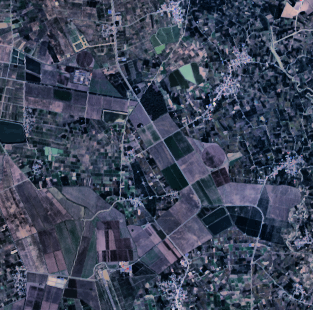

In [ ]:
fig = px.imshow(stretched)

fig.update_layout(
    autosize=False,
    width=750,
    height=750,
    margin=dict(
        l=10,
        r=10,
        b=10,
        t=10,
        pad=4
    )
)
fig.show()

## resampeloing the dem into the same pixel size as Landsat pixels

In [ ]:
dem = cv.resize(dem,(l1b2.shape[1],l1b2.shape[0]),cv.INTER_NEAREST)

In [ ]:
print(l1b2.shape,dem.shape)

(310, 313) (310, 313)


making Figures sizes bigger:

In [ ]:
plt.rcParams['figure.figsize'] = [30,10]

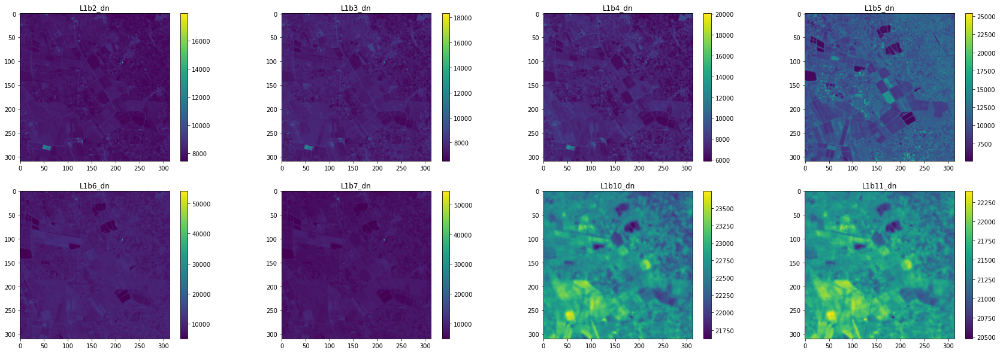

In [ ]:
l1_dns = [l1b2,l1b3,l1b4,l1b5,l1b6,l1b7,l1b10,l1b11]

fig, ax = plt.subplots(2, 4)
k = 0
t = 0
for i in range(2):
    for j in range(4):

         im = ax[i, j].imshow(l1_dns[k])
         ax[i, j].set_title('L1b' + str(k+2+t) + '_dn')
         plt.colorbar(im, ax=ax[i, j])
         k += 1
         if k == 6:
            t = 2 # for the bands 10 and 11, t is is for their title, so after 7 comes 10 instead of 8 in the plot
plt.show()


## computing the radiance for each band

* Grescale (Gain) is found for each band from the RADIANCE_MULT_BAND_x field of the Landsat metadata file.
* Brescale (Bias) is found for each band from the RADIANCE_ADD_BAND_x field of the Landsat metadata file.

from the MLT file we have:


In [ ]:
RADIANCE_MULT_BAND_2 = 1.3159E-02
RADIANCE_MULT_BAND_3 = 1.2126E-02
RADIANCE_MULT_BAND_4 = 1.0225E-02
RADIANCE_MULT_BAND_5 = 6.2571E-03
RADIANCE_MULT_BAND_6 = 1.5561E-03
RADIANCE_MULT_BAND_7 = 5.2449E-04
RADIANCE_MULT_BAND_10 = 3.3420E-04
RADIANCE_MULT_BAND_11 = 3.3420E-04

RADIANCE_ADD_BAND_2 = -65.79296
RADIANCE_ADD_BAND_3 = -60.62765
RADIANCE_ADD_BAND_4 = -51.12465
RADIANCE_ADD_BAND_5 = -31.28574
RADIANCE_ADD_BAND_6 = -7.78048
RADIANCE_ADD_BAND_7 = -2.62244
RADIANCE_ADD_BAND_10 = 0.10000
RADIANCE_ADD_BAND_11 = 0.10000


### a function to calculate the radiance
$L_{\lambda}=($ Gain $\times D N)+$ Bias

* note that this radiance is actualy `TOA (Top of Atmospheric) spectral radiance`

(Watts/( m2 * srad * μm))

which means it is per unit of wavelength

In [ ]:
def dn2radiance(dn_raster,gain = 1, bias = 1):
  radiance = gain*dn_raster + bias
  return radiance

In [ ]:
l1b2_radiance = dn2radiance(l1b2,RADIANCE_MULT_BAND_2,RADIANCE_ADD_BAND_2)
l1b3_radiance = dn2radiance(l1b3,RADIANCE_MULT_BAND_3,RADIANCE_ADD_BAND_3)
l1b4_radiance = dn2radiance(l1b4,RADIANCE_MULT_BAND_4,RADIANCE_ADD_BAND_4)
l1b5_radiance = dn2radiance(l1b5,RADIANCE_MULT_BAND_5,RADIANCE_ADD_BAND_5)
l1b6_radiance = dn2radiance(l1b6,RADIANCE_MULT_BAND_6,RADIANCE_ADD_BAND_6)
l1b7_radiance = dn2radiance(l1b7,RADIANCE_MULT_BAND_7,RADIANCE_ADD_BAND_7)

l1b10_radiance = dn2radiance(l1b10,RADIANCE_MULT_BAND_10,RADIANCE_ADD_BAND_10)
l1b11_radiance = dn2radiance(l1b11,RADIANCE_MULT_BAND_11,RADIANCE_ADD_BAND_11)


### NOTE: you can actually validate if your Calculated Radiance is right or not
in the MTL file there's a section like this that tells you what are the max and min for Radiance

```
  GROUP = LEVEL1_MIN_MAX_RADIANCE
    RADIANCE_MAXIMUM_BAND_1 = 777.87683
    RADIANCE_MINIMUM_BAND_1 = -64.23732
    RADIANCE_MAXIMUM_BAND_2 = 796.55536
    RADIANCE_MINIMUM_BAND_2 = -65.77980
    RADIANCE_MAXIMUM_BAND_3 = 734.01892
    RADIANCE_MINIMUM_BAND_3 = -60.61552
    RADIANCE_MAXIMUM_BAND_4 = 618.96613
    RADIANCE_MINIMUM_BAND_4 = -51.11442
    RADIANCE_MAXIMUM_BAND_5 = 378.77640
    RADIANCE_MINIMUM_BAND_5 = -31.27948
    RADIANCE_MAXIMUM_BAND_6 = 94.19824
    RADIANCE_MINIMUM_BAND_6 = -7.77892
    RADIANCE_MAXIMUM_BAND_7 = 31.74985
    RADIANCE_MINIMUM_BAND_7 = -2.62191
    RADIANCE_MAXIMUM_BAND_8 = 700.49927
    RADIANCE_MINIMUM_BAND_8 = -57.84746
    RADIANCE_MAXIMUM_BAND_9 = 148.03441
    RADIANCE_MINIMUM_BAND_9 = -12.22473
    RADIANCE_MAXIMUM_BAND_10 = 22.00180
    RADIANCE_MINIMUM_BAND_10 = 0.10033
    RADIANCE_MAXIMUM_BAND_11 = 22.00180
    RADIANCE_MINIMUM_BAND_11 = 0.10033
  END_GROUP = LEVEL1_MIN_MAX_RADIANCE
```

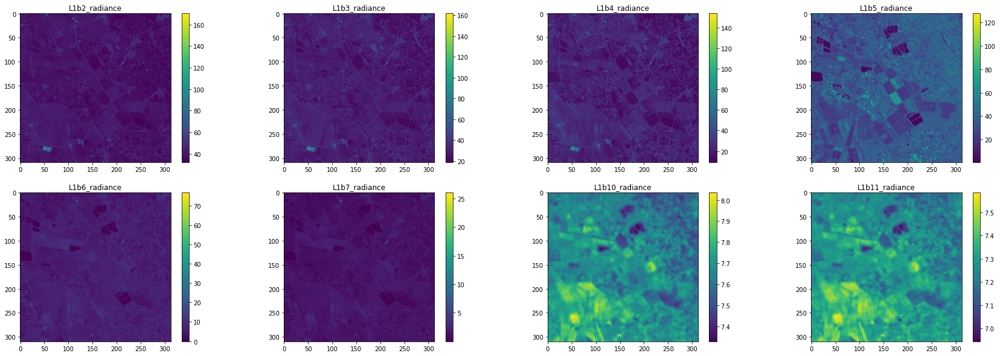

In [ ]:
l1_radinaces = [l1b2_radiance,l1b3_radiance,l1b4_radiance,l1b5_radiance,l1b6_radiance,l1b7_radiance,l1b10_radiance,l1b11_radiance]

fig, ax = plt.subplots(2, 4)
k = 0
t = 0
for i in range(2):
    for j in range(4):

         im = ax[i, j].imshow(l1_radinaces[k])
         ax[i, j].set_title('L1b' + str(k+2+t) + '_radiance')
         plt.colorbar(im, ax=ax[i, j])
         k += 1
         if k == 6:
            t = 2 # for the bands 10 and 11, t is is for their title, so after 7 comes 10 instead of 8 in the plot
plt.show()

In [ ]:
plt.rcParams['figure.figsize'] = [20,10]


## Calculating the Reflectance raster from MTL file

https://www.usgs.gov/landsat-missions/using-usgs-landsat-level-1-data-product

Reflective band DN’s can be converted to TOA reflectance using the rescaling coefficients in the MTL file:  

$\rho_{\lambda}^{\prime}=M_{\rho} Q_{c a l}+A_{\rho}$

```
ρλ'   = TOA planetary reflectance, without correction for solar angle.  Note that ρλ' does not contain a correction for the sun angle.

Mρ=Band-specific multiplicative rescaling factor from the metadata (REFLECTANCE_MULT_BAND_x, where x is the band number)

Aρ  =Band-specific additive rescaling factor from the metadata (REFLECTANCE_ADD_BAND_x, where x is the band number)

Qcal =  Quantized and calibrated standard product pixel values (DN)
```

TOA reflectance with a correction for the sun angle is then:

$\rho_{\lambda}=\frac{\rho_{\lambda}^{\prime}}{\cos \left(\theta_{S Z}\right)}=\frac{\rho_{\lambda}^{\prime}}{\sin \left(\theta_{S E}\right)}$

where:

```
ρλ=  TOA planetary reflectance

θSE =  Local sun elevation angle. The scene center sun elevation angle in
degrees is provided in the metadata (SUN_ELEVATION).

θSZ =Local solar zenith angle;  θSZ = 90° - θSE
```

in the MTL we have:
```
    REFLECTANCE_MULT_BAND_1 = 2.0000E-05
    REFLECTANCE_MULT_BAND_2 = 2.0000E-05
    REFLECTANCE_MULT_BAND_3 = 2.0000E-05
    REFLECTANCE_MULT_BAND_4 = 2.0000E-05
    REFLECTANCE_MULT_BAND_5 = 2.0000E-05
    REFLECTANCE_MULT_BAND_6 = 2.0000E-05
    REFLECTANCE_MULT_BAND_7 = 2.0000E-05
    REFLECTANCE_MULT_BAND_8 = 2.0000E-05
    REFLECTANCE_MULT_BAND_9 = 2.0000E-05
    REFLECTANCE_ADD_BAND_1 = -0.100000
    REFLECTANCE_ADD_BAND_2 = -0.100000
    REFLECTANCE_ADD_BAND_3 = -0.100000
    REFLECTANCE_ADD_BAND_4 = -0.100000
    REFLECTANCE_ADD_BAND_5 = -0.100000
    REFLECTANCE_ADD_BAND_6 = -0.100000
    REFLECTANCE_ADD_BAND_7 = -0.100000
    REFLECTANCE_ADD_BAND_8 = -0.100000
    REFLECTANCE_ADD_BAND_9 = -0.100000
```
since all of them have the same values, we just use 2 variables to represent them all

In [ ]:
REFLECTANCE_MULT = 2.0000E-05
REFLECTANCE_ADD = -0.100000

from the header we have

`SUN_ELEVATION = 32.34575449`

In [ ]:
SUN_AZIMUTH = 160.81742061
SUN_ELEVATION = 32.34575449
EARTH_SUN_DISTANCE = 0.9884832
incident_angle = 90 - SUN_ELEVATION # or zenith angle

In [ ]:
dr = 1/EARTH_SUN_DISTANCE**2
print(dr)

1.0234377094419422


In [ ]:
def dn2reflectance(dn_raster,gain = REFLECTANCE_MULT, bias = REFLECTANCE_ADD,sun_elev =SUN_ELEVATION):
  reflectance = (gain*dn_raster + bias)/ np.sin(np.radians(sun_elev))
  return reflectance

In [ ]:
l1b2_reflectance = dn2reflectance(l1b2)
l1b3_reflectance = dn2reflectance(l1b3)
l1b4_reflectance = dn2reflectance(l1b4)
l1b5_reflectance = dn2reflectance(l1b5)
l1b6_reflectance = dn2reflectance(l1b6)
l1b7_reflectance = dn2reflectance(l1b7)

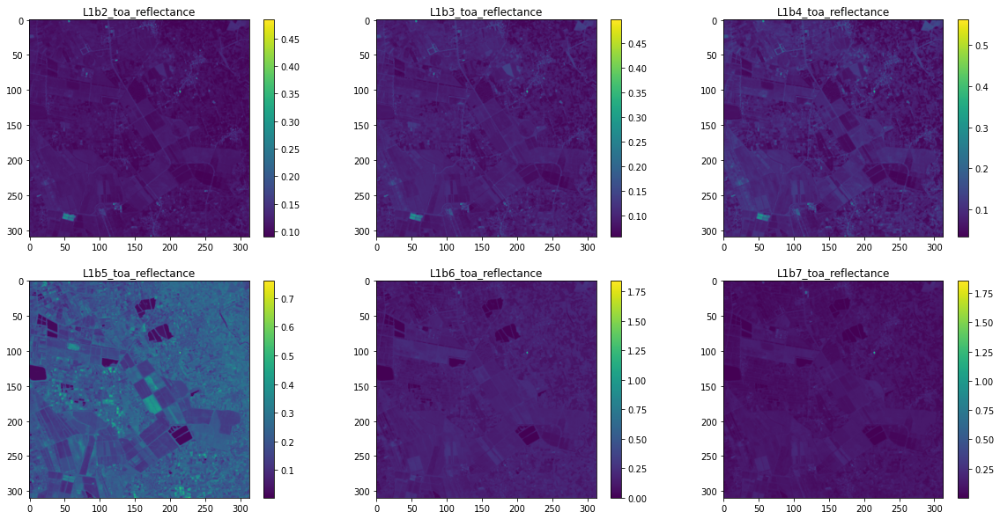

In [ ]:
l1_reflectances = [l1b2_reflectance,l1b3_reflectance,l1b4_reflectance,l1b5_reflectance,l1b6_reflectance,l1b7_reflectance]

fig, ax = plt.subplots(2, 3)
k = 0
for i in range(2):
    for j in range(3):

         im = ax[i, j].imshow(l1_reflectances[k])
         ax[i, j].set_title('L1b' + str(k+2) + '_toa_reflectance')
         plt.colorbar(im, ax=ax[i, j])
         k += 1
plt.show()

## Calculating exactESUNs for our data
in comparision of the reflectevity and reflectance we proved that our ESUNs are `almost`correct but to calculate the exact amount for our scene we can do this:

paper:

`Procedures for calculation of the albedo with OLI-Landsat 8 images:
Application to the Brazilian semi-arid`

so we had:

$\rho_{\lambda}=\frac{\pi \cdot L_{\lambda}}{E S U N_{\lambda} \cdot \cos \theta \cdot d_{r}}$

to calculate ESUN we have

$E S U N_{\lambda}=\frac{\pi \cdot L_{\lambda}}{\rho_{\lambda} \cdot \cos \theta \cdot d_{r}}$

In [ ]:
def esun_calculator(radiance_raster,reflectance_raster,zenith_angle,dr):
  esun_raster = (np.pi*radiance_raster) / (reflectance_raster*np.cos(np.radians(zenith_angle))*dr)
  return np.mean(esun_raster)

In [ ]:
esun2 = esun_calculator(l1b2_radiance,l1b2_reflectance,incident_angle,dr)
esun3 = esun_calculator(l1b3_radiance,l1b3_reflectance,incident_angle,dr)
esun4 = esun_calculator(l1b4_radiance,l1b4_reflectance,incident_angle,dr)
esun5 = esun_calculator(l1b5_radiance,l1b5_reflectance,incident_angle,dr)
esun6 = esun_calculator(l1b6_radiance,l1b6_reflectance,incident_angle,dr)
esun7 = esun_calculator(l1b7_radiance,l1b7_reflectance,incident_angle,dr)

In [ ]:
print(esun2,
esun3,
esun4,
esun5,
esun6,
esun7)

2019.7796562748765 1861.2746436967318 1569.3829080742305 960.3460702960608 238.83526269500877 80.50105302300764


## Albedo Level 1

from sebal we have:

$\alpha_{\mathrm{toa}}=\Sigma\left(\omega_{\lambda} \times \rho_{\lambda}\right)$

$\omega_{\lambda}=\frac{E S U N_{\lambda}}{\sum E S U N_{\lambda}}$

In [ ]:
esuns = [esun2,esun3,esun4,esun5,esun6,esun7]
reflectances = [l1b2_reflectance,l1b3_reflectance,l1b4_reflectance,l1b5_reflectance,l1b6_reflectance,l1b7_reflectance]
esuns_sum = sum(esuns)
albedo_toa = np.zeros(l1b2_reflectance.shape)
for esun,ref in zip(esuns,reflectances):
  albedo_toa += (esun/esuns_sum)*ref
  print('esun weight',(esun/esuns_sum))


esun weight 0.30011051483506446
esun weight 0.276558925541162
esun weight 0.23318796733707178
esun weight 0.14269376002525627
esun weight 0.03548752133703651
esun weight 0.011961310924408955


In [ ]:
print(np.min(albedo_toa),np.mean(albedo_toa),np.max(albedo_toa))

0.0549717717676238 0.11481513819511377 0.6107861453267249


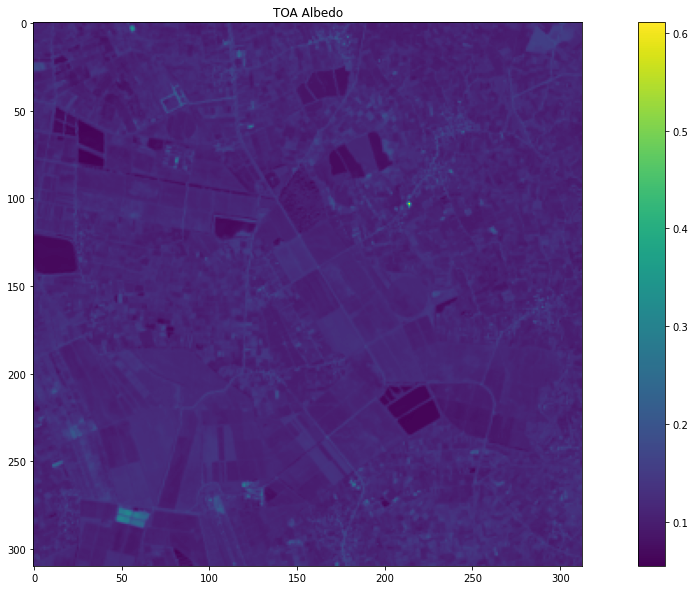

In [ ]:
plt.imshow(albedo_toa)
plt.title('TOA Albedo')
plt.colorbar()

### surface albedo form Level 1

$\alpha=\frac{\alpha_{\text {toa }}-\alpha_{\text {path_radiance }}}{\tau_{s w}^{2}}$

 "*Values for `αpath_radiance` range between 0.025 and 0.04 and for SEBAL we recommend a
value of `0.03` based on Bastiaanssen (2000).*"

τsw
is the atmospheric transmissivity.

$\tau_{\mathrm{sw}}=0.75+2 \times 10^{-5} \times \mathrm{z}$

where; `z` is the elevation above sea level (m).



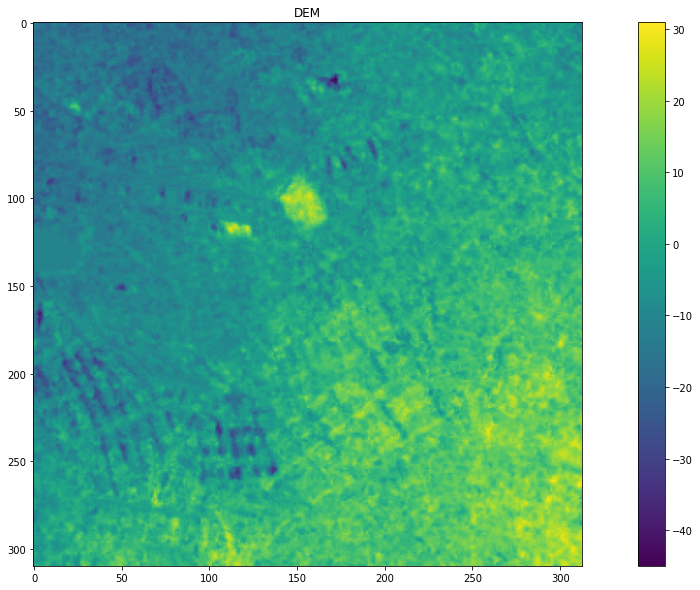

In [ ]:
plt.imshow(dem)
plt.title('DEM')
plt.colorbar()

In [ ]:
taw = 0.75 + 2E-5 * dem

#### atmospheric transmissivity

since our area is flat, elevation doesn't have a great effect on the atmospheric transmissivity reasults

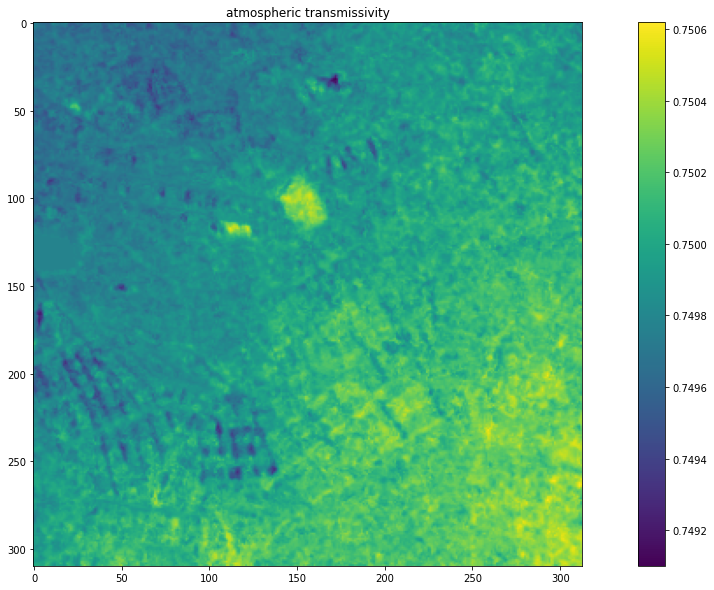

In [ ]:
plt.imshow(taw)
plt.title('atmospheric transmissivity')
plt.colorbar()

In [ ]:
l1_surface_albedo = (albedo_toa - 0.03)/taw**2

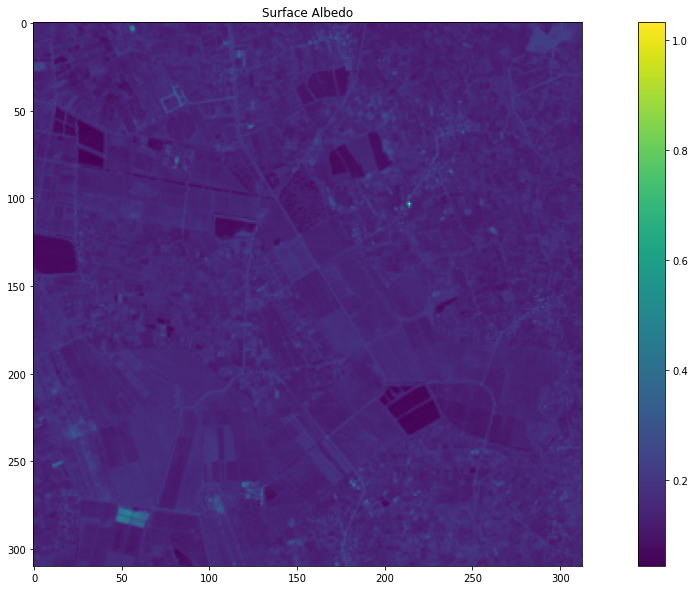

In [ ]:
plt.imshow(l1_surface_albedo)
plt.title('Surface Albedo')
plt.colorbar()

#  Incoming Shortwave Radiation $R_{s \downarrow}$

$R_{s \downarrow}=G_{s c} \times \cos \theta \times d_{r} \times \tau_{s w}$

```
where; Gsc is the solar constant (1367 W/m2),
cos θ is the cosine of the solar incidence angle as in step 2 above,
dr is the inverse squared relative earth-sun distance, and
τsw is the atmospheric transmissivity. This calculation is done with a spreadsheet or calculator.
Values for Rs↓ can range from 200 – 1000 W/m2
depending on the time and location of the
image.
```

In [ ]:
r_short_down = 1367 * np.cos(np.radians(incident_angle)) * dr * taw

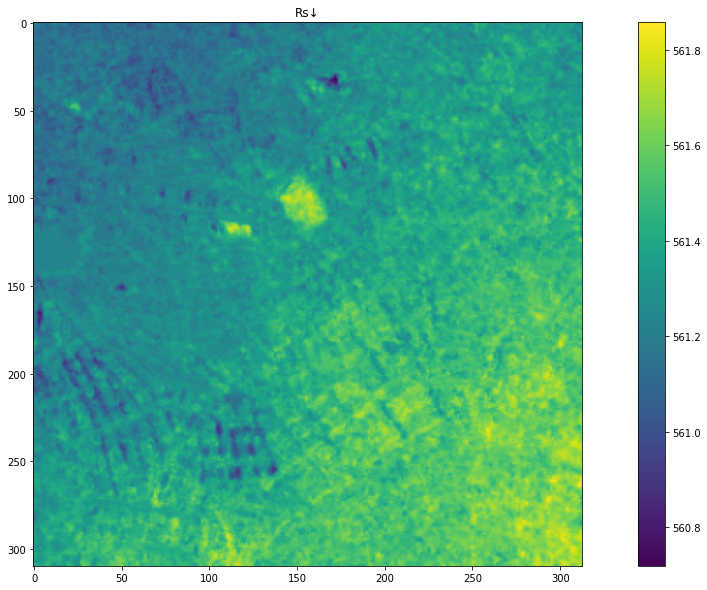

In [ ]:
plt.imshow(r_short_down)
plt.title('Rs↓')
plt.colorbar()

# Outgoing Longwave Radiation (RL↑)

## NDVI

NDVI $=\left(\rho_{5}-\rho_{4}\right) /\left(\rho_{5}+\rho_{4}\right)$

the negative values we are getting for our NDVI are because of the muddyness of the ponds which makes them have reflectance in RED but not in NIR.(?)

In [ ]:
ndvi = (l1b5_reflectance - l1b4_reflectance)/(l1b5_reflectance + l1b4_reflectance)

0.38854038562537596


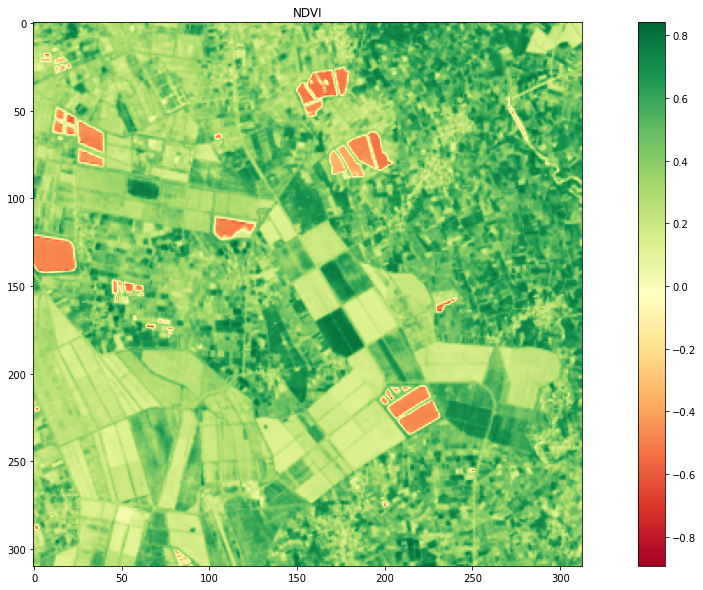

In [ ]:
print(np.mean(ndvi))
plt.imshow(ndvi,cmap='RdYlGn')
plt.title('NDVI')
plt.colorbar()

## SAVI

$\mathrm{SAVI}=(1+\mathrm{L})\left(\rho_{5}-\rho_{4}\right) /\left(\mathrm{L}+\rho_{5}+\rho_{4}\right)$


L is a constant for SAVI. If L is zero, SAVI becomes equal to NDVI. A value of 0.5 frequently appears in the literature for L. However, a value of 0.1 is used to better 19
represent soils of southern Idaho.

In [ ]:
L = 0.1
savi = (1+L)*(l1b5_reflectance - l1b4_reflectance)/(L+l1b5_reflectance + l1b4_reflectance)

0.32374152408580864
0.7907111098852743


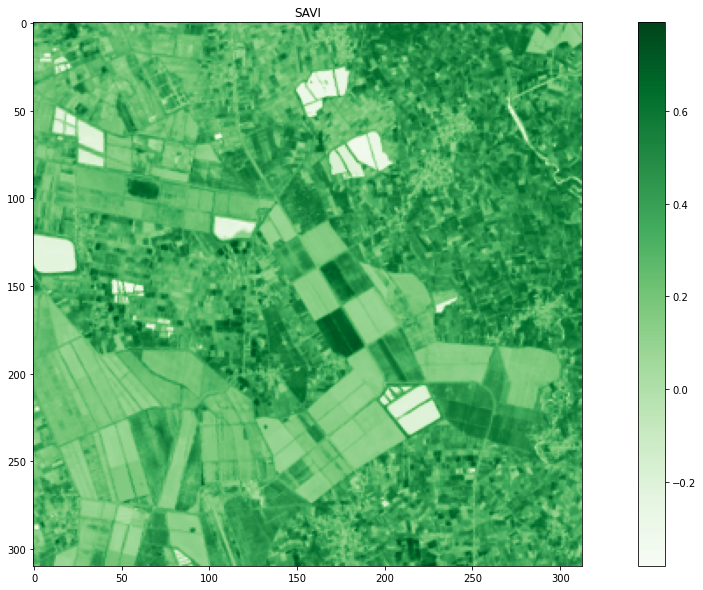

In [ ]:
print(np.mean(savi))
print(np.max(savi))
plt.imshow(savi,cmap='Greens')
plt.title('SAVI')
plt.colorbar()

(array([[  0.,  16.,   1., ...,  16.,   6.,   2.],
        [  1.,  19.,   1., ...,  21.,   5.,   0.],
        [  2.,  20.,   1., ...,  17.,   2.,   0.],
        ...,
        [  0.,   0.,   0., ..., 111.,  43.,   0.],
        [  0.,   0.,   0., ..., 108.,  47.,   0.],
        [  0.,   0.,   0., ..., 107.,  41.,   2.]]),
 array([-0.38036565, -0.26325797, -0.1461503 , -0.02904262,  0.08806506,
         0.20517273,  0.32228041,  0.43938808,  0.55649576,  0.67360343,
         0.79071111]),
 <a list of 313 Lists of Patches objects>)

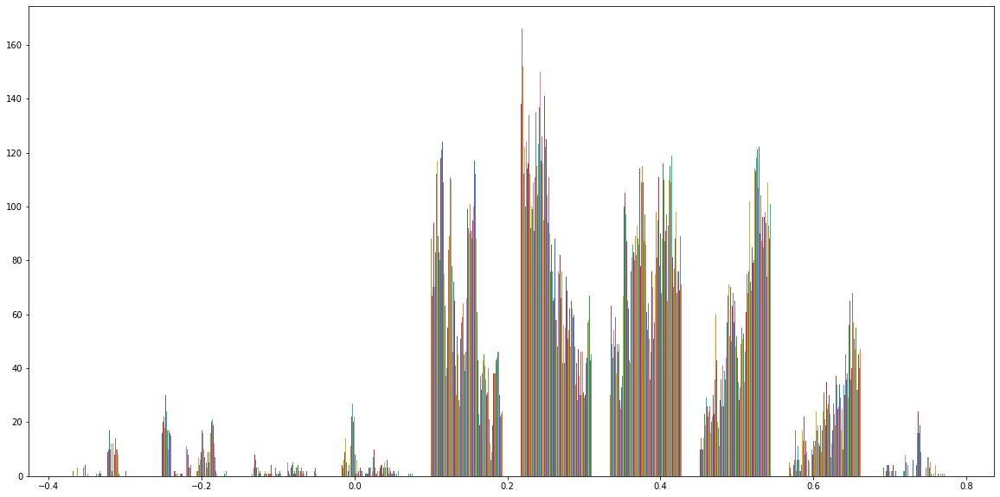

In [ ]:
plt.hist(savi)

## LAI

$L A I=-\frac{\ln \left(\frac{0.69-S A V I_{I D}}{0.59}\right)}{0.91}$

for `SAVI` values `equal or greater than 0.69` the out put of logrithm is `NaN` and since these values mean high vegetataion density, we set the `log` to `6`. the max value defined in SEBAL manual, which results in `LAI` being `6.5`

(the `-` behind 6 is becauase log of numbers below 0 is negative, an it is compensated in the last line.)

In [ ]:
log = np.log((0.69 - savi)/0.59)
log[np.isnan(log)] = -6
lai = -(log/0.91)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: RuntimeWarning:

invalid value encountered in log



(array([[196., 101.,  10., ...,   0.,   0.,   0.],
        [224.,  77.,   9., ...,   0.,   0.,   0.],
        [218.,  88.,   4., ...,   0.,   0.,   0.],
        ...,
        [ 41., 195.,  70., ...,   0.,   0.,   0.],
        [ 51., 183.,  66., ...,   0.,   0.,   0.],
        [ 53., 186.,  65., ...,   0.,   0.,   1.]]),
 array([-0.65454182,  0.36529517,  1.38513217,  2.40496916,  3.42480616,
         4.44464315,  5.46448015,  6.48431714,  7.50415414,  8.52399113,
         9.54382812]),
 <a list of 313 Lists of Patches objects>)

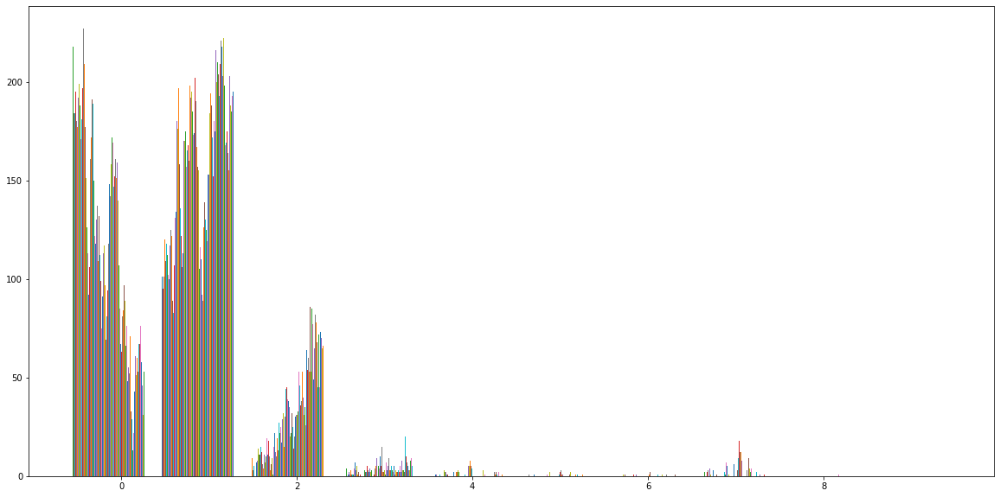

In [ ]:
plt.hist(lai)

## os

-0.6545418225124303 0.6890132714229572


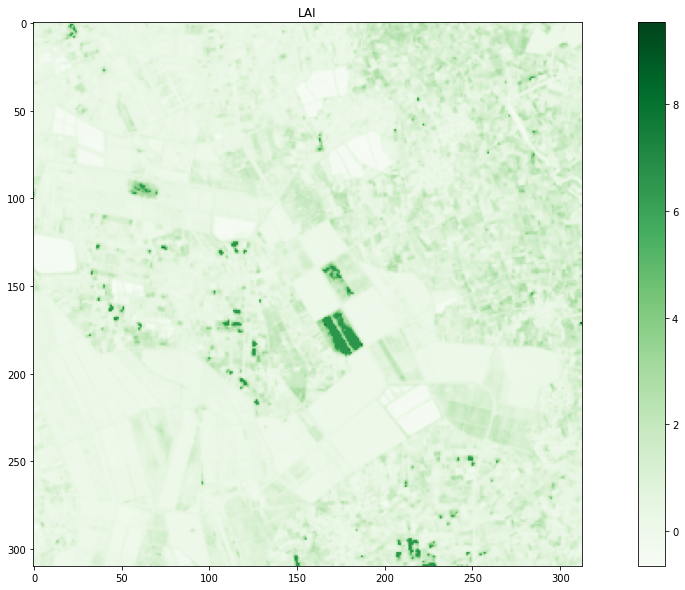

In [ ]:
print(np.min(lai),np.mean(lai))
plt.imshow(lai,cmap='Greens')
plt.title('LAI')
plt.colorbar()

## Surface emissivity (ε)

Two surface
emissivities are used in SEBAL. The first is an emissivity representing surface behavior for thermal emission in the relatively `narrow band 6 of Landsat` `(10.4 to 12.5 µm)`, expressed as `εΝΒ`. The second is an emissivity representing surface behavior for thermal emission in the `broad thermal spectrum (6 to 14 µm)`, expressed as `εο`. `εΝΒ` is used in calculation of `surface temperature ``(Ts)` and `εο` is used later on to calculate `total long wave radiation` emission from the surface.

The surface emissivities are computed in model F06 using the following empirical equations, where` NDVI > 0`:

$\begin{array}{ll}\varepsilon_{\mathrm{NB}}=0.97+0.0033 \mathrm{LAl} ; & \text { for } \mathrm{LAl}<3 \\ \varepsilon_{0}=0.95+0.01 \mathrm{LAl} ; & \text { for } \mathrm{LAl}<3\end{array}$
and $\varepsilon_{\mathrm{NB}}=0.98$ and $\varepsilon_{0}=0.98$ when $\mathrm{LAl} \geq 3$


=====

- For water; NDVI $<0$ and $\alpha<0.47$,
$\varepsilon_{\mathrm{NB}}=0.99$ and $\varepsilon_{0}=0.985$
- For snow; NDVI $<0$ and $\alpha \geq 0.47$,
$\varepsilon_{\mathrm{NB}}=0.99$ and $\varepsilon_{\mathrm{o}}=0.985$

In [ ]:
print(ndvi.shape)
enb = np.zeros(ndvi.shape)
e0 = np.zeros(ndvi.shape)

(310, 313)


In [ ]:
enb[np.logical_and(ndvi>0, lai<3)] = 0.97+0.0033*lai[np.logical_and(ndvi>0, lai<3)]
e0[np.logical_and(ndvi>0 , lai<3)] = 0.95+0.01*lai[np.logical_and(ndvi>0 , lai<3)]


enb[np.logical_and(ndvi>0 , lai>=3)] = 0.98
e0 [np.logical_and(ndvi>0 , lai>=3)] = 0.98

enb[np.logical_and(ndvi<=0 , l1_surface_albedo<0.47)] = 0.99
e0 [np.logical_and(ndvi<=0 , l1_surface_albedo<0.47)] = 0.985

enb[np.logical_and(ndvi<=0 , l1_surface_albedo>=0.47)] = 0.99
e0 [np.logical_and(ndvi<=0 , l1_surface_albedo>=0.47)] = 0.985

0.9727901047521231


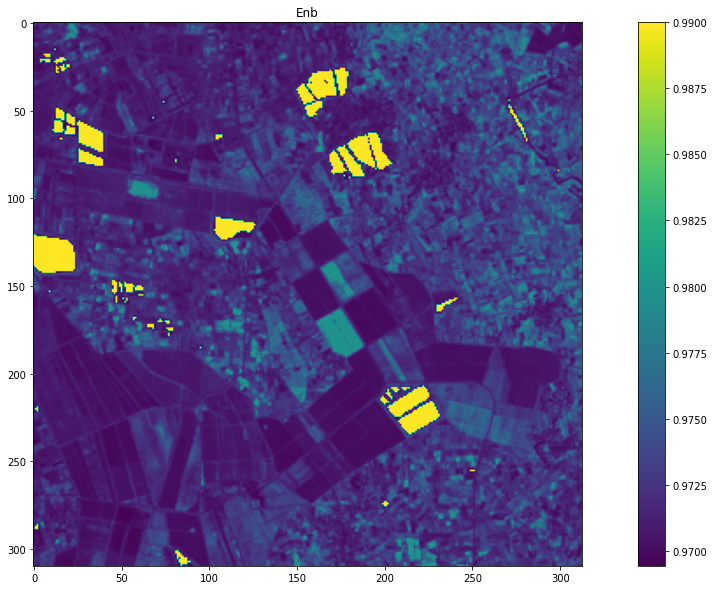

In [ ]:
print(np.mean(enb))
plt.imshow(enb)
plt.title('Enb')
plt.colorbar()

0.957747326322022


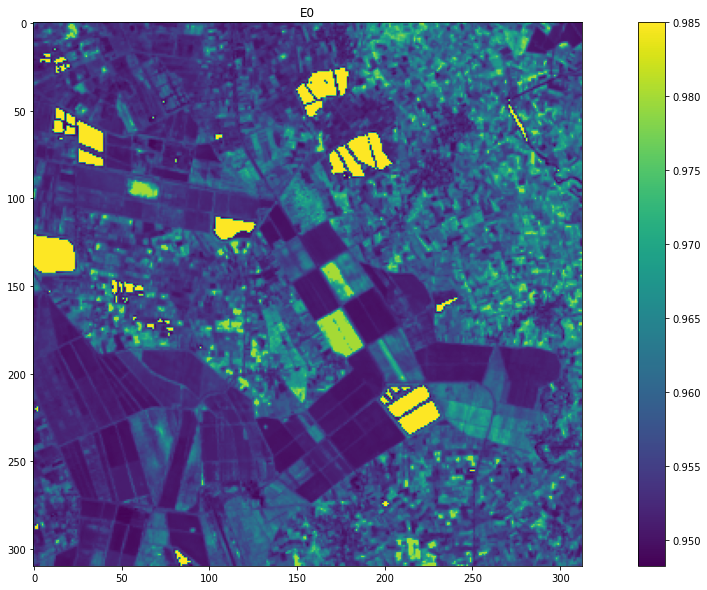

In [ ]:
print(np.mean(e0))
plt.imshow(e0)
plt.title('E0')
plt.colorbar()

[How to calculate Land Surface Temperature with Landsat 8 satellite images](https://giscrack.com/how-to-calculate-land-surface-temperature-with-landsat-8-images/)

from this we know that we can find the K1_constant and K2_constant in the MTL file.

```
  GROUP = LEVEL1_THERMAL_CONSTANTS
    K1_CONSTANT_BAND_10 = 774.8853
    K2_CONSTANT_BAND_10 = 1321.0789
    K1_CONSTANT_BAND_11 = 480.8883
    K2_CONSTANT_BAND_11 = 1201.1442
```

## Specteral Radiance



so we don't use band 11
but SEBAL for landsat 7 uses band6 which is from 10.4 to 12.5 µm

landsat 8 band 10 is from 10.6 to 11.19

landsat 8 band 11 is from 11.5 to 12.51

so since the TOA spectral radiance Unit is (Watts/( m2 * srad * μm)), can we multiply both band 10 and 11 spectral radiances with theri bandwidth then sum them up and devide them by the whole bandwidth?

then we would get almost the same band width for landsat 7 and 8 but what do we do with the K constants?

here I just use band 10 - but will keep looking for the above answer

- the answer probabliy is to use an LST method desighned for landsat 8 and not the one explained in SEBAL which is for landsat 7


we only use band 10 so we abreviate the Constants name and we remove the band name from it.

In [ ]:
K1 = 774.8853
K2 = 1321.0789


$\mathrm{R}_{\mathrm{c}}=\frac{\mathrm{L}_{6}-\mathrm{R}_{\mathrm{p}}}{\tau_{\mathrm{NB}}}-\left(1-\varepsilon_{\mathrm{NB}}\right) \mathrm{R}_{\mathrm{sky}}$

${\tau_{\mathrm{NB}}}$ = 0

Rp = 0

Rsky = 0

Therefore:

`Rc = Lc`



In [ ]:
rc = l1b10_radiance

## LST (Ts)

$\mathrm{T}_{\mathrm{s}}=\frac{\mathrm{K}_{2}}{\ln \left(\frac{\varepsilon_{\mathrm{NB}} \mathrm{K}_{1}}{\mathrm{R}_{\mathrm{c}}}+1\right)}$

In [ ]:
inside_log = ((enb * K1) / rc) + 1

Ts = K2 / np.log(inside_log)

287.2973283752698


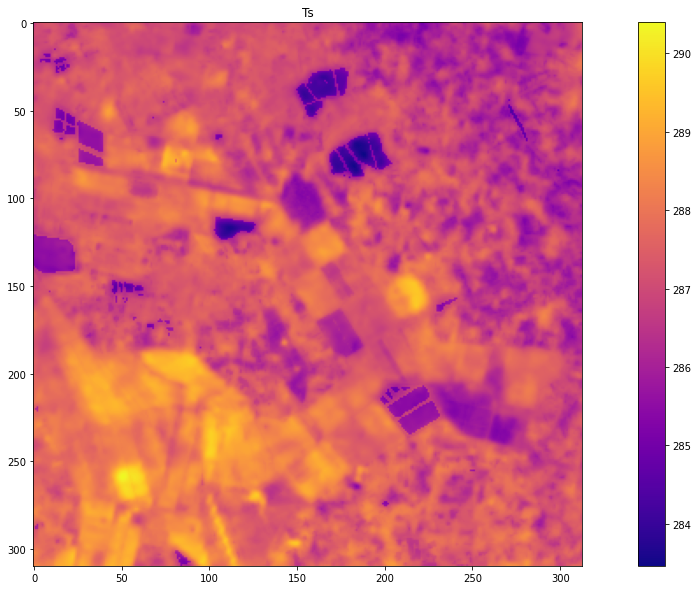

In [ ]:
print(np.mean(Ts))
plt.imshow(Ts,cmap='plasma')
plt.title('Ts')
plt.colorbar()

## The outgoing longwave radiation (RL↑)

$\mathrm{R}_{\mathrm{L} \uparrow}=\varepsilon_{0} \times \sigma \times \mathrm{T}_{\mathrm{s}}^{4}$

where; εο is the “broad-band” surface emissivity (dimensionless), σ is the Stefan-Boltzmann constant (5.67 × 10-8 W/m2/K4), and Ts is the surface temperature (K).

In [ ]:
sigma = 5.67E-08
r_long_up = e0 * sigma * Ts**4

Values for RL↑ can range from 200 – 700 W/m2 depending on the location and time of the image.

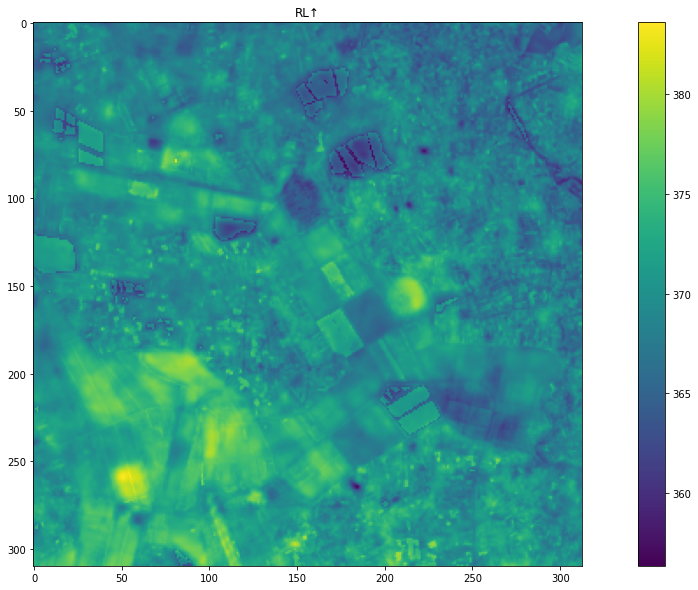

In [ ]:
plt.imshow(r_long_up)
plt.title('RL↑')
plt.colorbar()

# Choosing the “Hot” and “Cold” Pixels

“cold” pixel is selected as a wet, well-irrigated crop surface having full ground cover by vegetation.

“hot” pixel is selected as a dry, bare agricultural field where ET is assumed to be zero.

### Plotly

to find the cold and hot pixels we need to inspect pixels, which is not possible with matplotlib in Colab. so we use the plotly library.

https://plotly.com/python/imshow/

https://community.plotly.com/t/is-there-a-way-to-display-multiple-images-for-comparison-pusporse/37922



pixel `x=52, y=257` is bare soil (low ndvi and looks like a dry soil and its hot) so we choose it as the `hot pixel`. (almost `290 kelvins`).





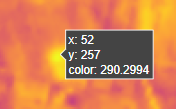

pixel `x=179, y =174` is well vegetated (high NDVI) so we choose it as the `cold pixel` (almost `286 kelvins`).

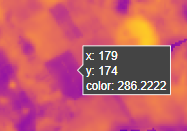

In [ ]:
HOT = 290
COLD = 286

In [ ]:
import plotly.express as px

In [ ]:
fig = px.imshow(Ts)
fig.update_layout(
    autosize=False,
    width=750,
    height=750,
    margin=dict(
        l=10,
        r=10,
        b=10,
        t=10,
        pad=4
    )
)
fig.show()

this sub plot of `RGB` and `FCC`, along the `LST` helps us to find the `cold` and `hot` pixels

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

unfortunaly I couldn't find the best way to show subplots, when you try to subplots two mono-channel images with very diffrent ranges, you'll get wrong outputs.

like when you want to plot NDVI and LST.

but I hadn't have a problem with ploting rgb images together or rgb images and only one mono-channel image (like lst or ndvi)
so I ploted `RGB` image and the `FCC` together (rgb images), and only one cmono-hannel image which was the `Ts`


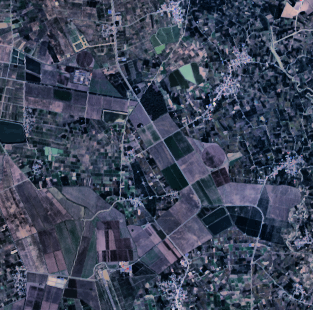
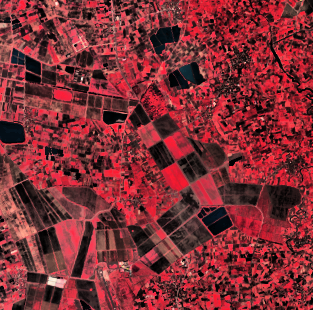

In [ ]:
fig = make_subplots(rows=1, cols=3,horizontal_spacing=0.01, shared_yaxes=True,subplot_titles=('RGB Image', 'False Color' , 'Ts'))
fig.add_trace(px.imshow(stretched).data[0], 1, 1)
fig.add_trace(px.imshow(fcc_stretched).data[0], 1, 2)
fig.add_trace(px.imshow(Ts).data[0], 1, 3)

fig.update_layout(
    autosize=False,
    width=1750,
    height=650,
    margin=dict(
        l=10,
        r=10,
        b=10,
        t=10,
        pad=4
    )
)
fig.show()

#  Incoming Longwave Radiation (RL↓)

$R_{L \downarrow}=0.85 \times\left(-\ln \tau_{\text {sw }}\right)^{.09} \times \sigma \times T_{\text {cold }}^{4}$

σ is the Stefan-Boltzmann constant (5.67 × 10-8 W/m2/K4), and Ta is the near surface air temperature (K).

τsw is the atmospheric transmissivity calculated before as `taw`

*Values for RL↓ can range from 200 – 500 W/m2*

In [ ]:
sigma = 5.67E-08
r_long_down = 0.85 * ((-1 * np.log(taw))**0.9) * sigma * (COLD**4)

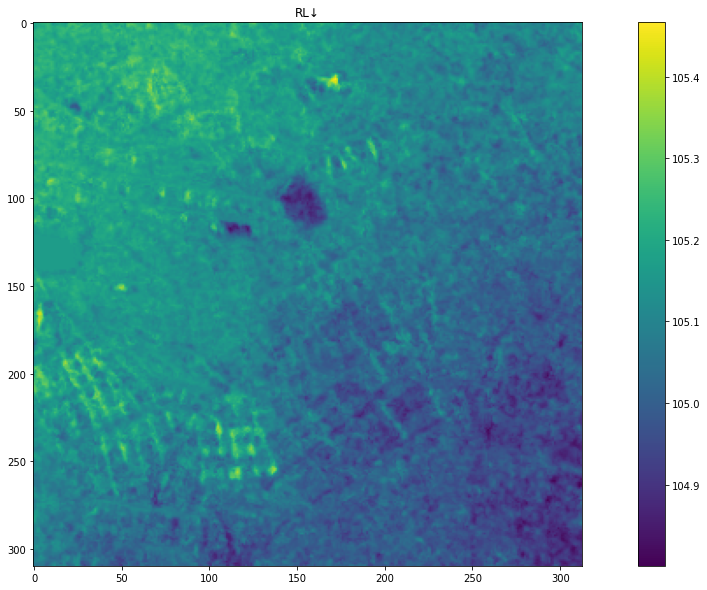

In [ ]:
plt.imshow(r_long_down)
plt.title('RL↓')
plt.colorbar()

## Lets Compare this LST with the LST from Level 2 products

In [ ]:
l2st_dn = plt.imread('/content/subset/L2/LC08__L2_ST_cliped.tif')
lst = 0.00341802*l2st_dn + 149.0

In [ ]:
plt.rcParams['figure.figsize'] = [25,10]

# Rn - FINALY!

$\mathrm{R}_{\mathrm{n}}=(1-\alpha) \mathrm{R}_{\mathrm{S} \downarrow}+\mathrm{R}_{\mathrm{L} \downarrow}-\mathrm{R}_{\mathrm{L} \uparrow}-\left(1-\varepsilon_{0}\right) \mathrm{R}_{\mathrm{L} \downarrow}$


`Rn can range from 100 – 700 W/m2, depending on the surface.`

In [ ]:
Rn = ((1-l1_surface_albedo)* r_short_down) + r_long_down - r_long_up - ((1-e0) * r_long_down)

In [ ]:
fig = px.imshow(Rn)
fig.update_layout(
    autosize=False,
    width=750,
    height=750,
    margin=dict(
        l=10,
        r=10,
        b=10,
        t=10,
        pad=4
    )
)
fig.show()

(array([[  0.,   0.,   0., ...,   3., 228.,  79.],
        [  0.,   0.,   0., ...,   3., 224.,  83.],
        [  0.,   0.,   0., ...,   3., 215.,  92.],
        ...,
        [  0.,   0.,   0., ...,   0., 188., 122.],
        [  0.,   0.,   0., ...,   0., 190., 120.],
        [  0.,   0.,   0., ...,   0., 182., 128.]]),
 array([-278.54147804, -223.93772874, -169.33397944, -114.73023013,
         -60.12648083,   -5.52273153,   49.08101778,  103.68476708,
         158.28851639,  212.89226569,  267.49601499]),
 <a list of 313 Lists of Patches objects>)

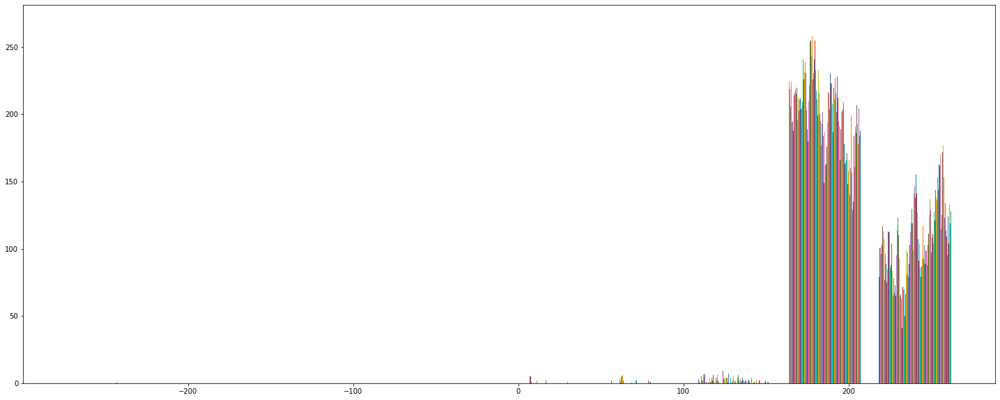

In [ ]:
plt.hist(Rn)

### Rn range

as said in sebal manulat the vlaid range of Rn is above 100 and by a look at our histogram we can see that we dont have many pixels below 100 so we cap them to 100 so we get better streching in our image

In [ ]:
Rn[Rn<100] = 100


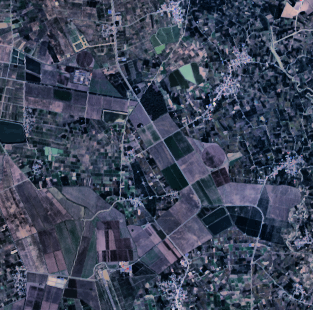
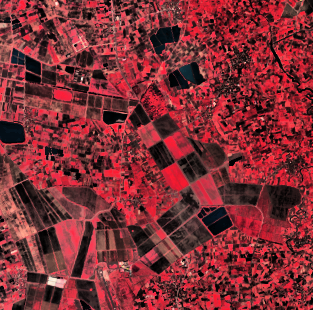

In [ ]:
fig = make_subplots(rows=1, cols=3,horizontal_spacing=0.01, shared_yaxes=True,subplot_titles=('RGB Image', 'False Color' , 'Rn'))
fig.add_trace(px.imshow(stretched).data[0], 1, 1)
fig.add_trace(px.imshow(fcc_stretched).data[0], 1, 2)
fig.add_trace(px.imshow(Rn).data[0], 1, 3)

fig.update_layout(
    autosize=False,
    width=1750,
    height=650,
    margin=dict(
        l=10,
        r=10,
        b=10,
        t=10,
        pad=4
    )
)
fig.show()

# APPENDIX 1 :  diffrence map between SEBAL LST and Level 2 LST

as we can see this diffrence is negligible

we also need to keep in mind that Level 2 data comes 16-17 days after aquistion, so it might not be suitble for real time crop monitoring.

In [ ]:
l2st_dn = plt.imread('/content/subset/L2/LC08__L2_ST_cliped.tif')
lst = 0.00341802*l2st_dn + 149.0

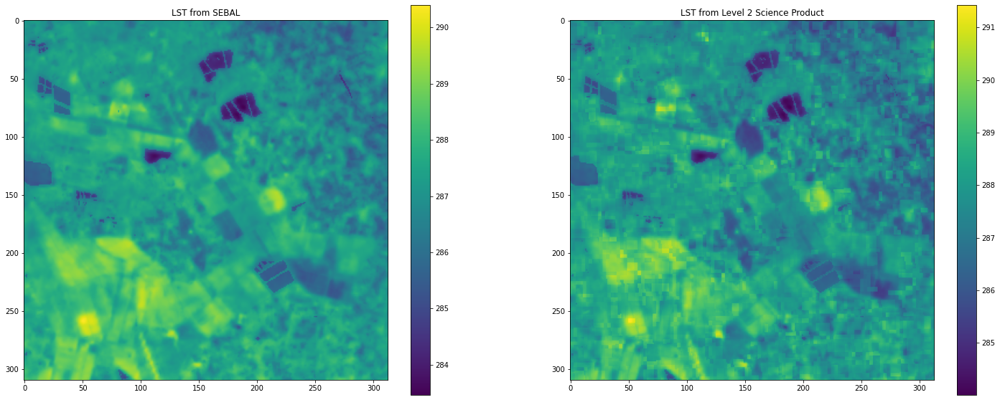

In [ ]:
fig, ax = plt.subplots(1, 2)


im = ax[0].imshow(Ts)
ax[0].set_title('LST from SEBAL')
plt.colorbar(im, ax=ax[0])

im = ax[1].imshow(lst)
ax[1].set_title('LST from Level 2 Science Product')
plt.colorbar(im, ax=ax[1])


plt.show()

In [ ]:
diff_lst = lst - Ts


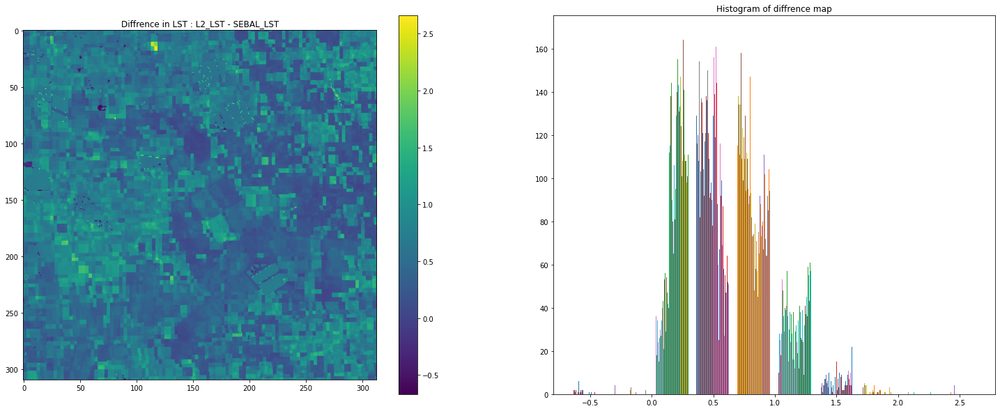

In [ ]:
fig, ax = plt.subplots(1, 2)


im = ax[0].imshow(diff_lst)
ax[0].set_title('Diffrence in LST : L2_LST - SEBAL_LST')
plt.colorbar(im, ax=ax[0])

im = ax[1].hist(diff_lst)
ax[1].set_title('Histogram of diffrence map')


plt.show()



# APPENDIX 2 :  Landsat Level 2 Sience prodcut

in
[USGS Landsat 8 Level 2, Collection 2, Tier 1 ](https://developers.google.com/earth-engine/datasets/catalog/LANDSAT_LC08_C02_T1_L2)
we have:


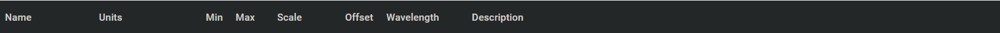

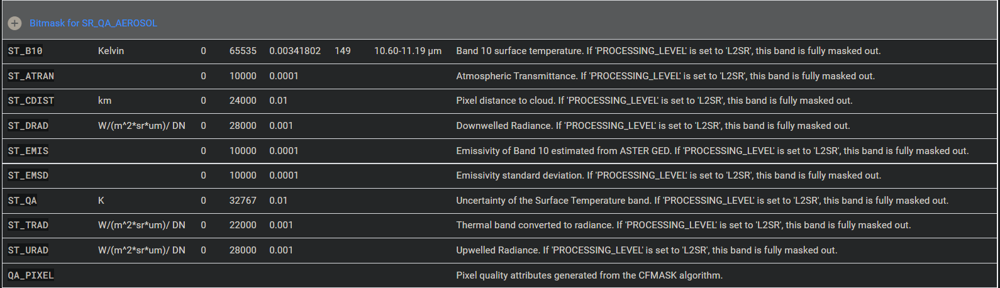

which lets us know how to use Level 2 products.

**but what is the `L2SR`?**

in the

**Landsat 8-9**
**Collection 2 (C2)**
**Level 2 Science Product (L2SP) Guide**

we have

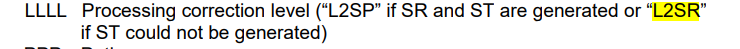

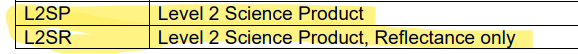

so we can find the answer in the file name which is:

LC08_`L2SP`_163035_20211118_20211125_02_T1_MTL

so our data has the `LST`

In [ ]:
# l2b2_dn = plt.imread('/content/subset/L2/LC08__L2_B2_cliped.tif')
# l2b3_dn = plt.imread('/content/subset/L2/LC08__L2_B3_cliped.tif')
# l2b4_dn = plt.imread('/content/subset/L2/LC08__L2_B4_cliped.tif')
# l2b5_dn = plt.imread('/content/subset/L2/LC08__L2_B5_cliped.tif')
# l2b6_dn = plt.imread('/content/subset/L2/LC08__L2_B6_cliped.tif')
# l2b7_dn = plt.imread('/content/subset/L2/LC08__L2_B7_cliped.tif')

l2st_dn = plt.imread('/content/subset/L2/LC08__L2_ST_cliped.tif')

l2atran_dn = plt.imread('/content/subset/L2/LC08__L2_atran_cliped.tif')
l2drad_dn = plt.imread('/content/subset/L2/LC08__L2_drad_cliped.tif')
l2emis_dn = plt.imread('/content/subset/L2/LC08__L2_emis_cliped.tif')
l2urad_dn = plt.imread('/content/subset/L2/LC08__L2_urad_cliped.tif')



somehow we had a wierd problem with reading, `.tif` files with plt, it reads them as `uint8` which I think thers somthing worong with the path or the name

## emistivity

In [ ]:
l2emis_dn = rasterio.open('/content/subset/L2/LC08__L2_emis_cliped.tif')
l2emis_dn =l2emis_dn.read()
l2emis_dn = l2emis_dn[0]

In [ ]:
l2emis_dn

array([[9749, 9749, 9749, ..., 9675, 9675, 9597],
       [9749, 9749, 9749, ..., 9675, 9675, 9597],
       [9749, 9749, 9749, ..., 9675, 9675, 9597],
       ...,
       [9829, 9736, 9736, ..., 9823, 9749, 9749],
       [9822, 9736, 9736, ..., 9819, 9749, 9749],
       [9812, 9736, 9736, ..., 9807, 9749, 9749]], dtype=int16)

In [ ]:
l2emis_dn.shape

(310, 313)

In [ ]:
emis = l2emis_dn * 0.0001

`[:,:,0]`

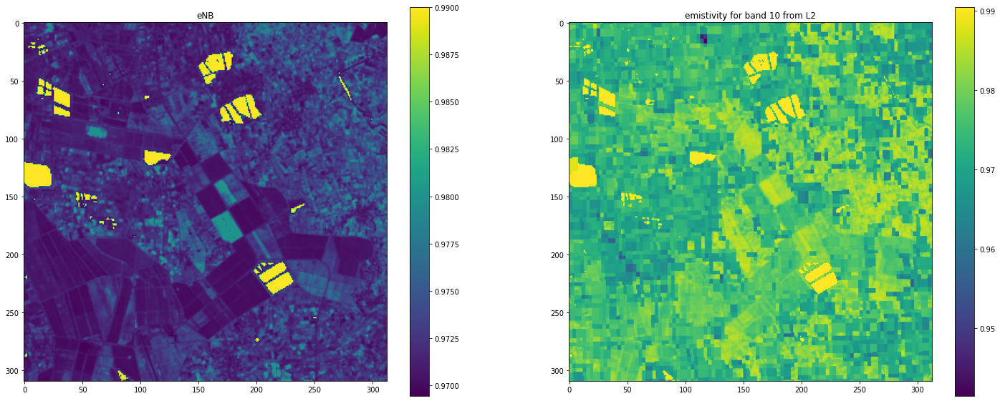

In [ ]:
fig, ax = plt.subplots(1, 2)


im = ax[0].imshow(enb)
ax[0].set_title('eNB')
plt.colorbar(im, ax=ax[0])

im = ax[1].imshow(emis)
ax[1].set_title('emistivity for band 10 from L2')
plt.colorbar(im, ax=ax[1])


plt.show()

## atmospheric transmitance

since our subset is for a small region we don't have good resolution for this, but for a large area I defenetly recomend using this.

In [ ]:
l2atran_dn = rasterio.open('/content/subset/L2/LC08__L2_atran_cliped.tif')
l2atran_dn =l2atran_dn.read()
l2atran_dn = l2atran_dn[0]

In [ ]:
atran = l2atran_dn * 0.0001

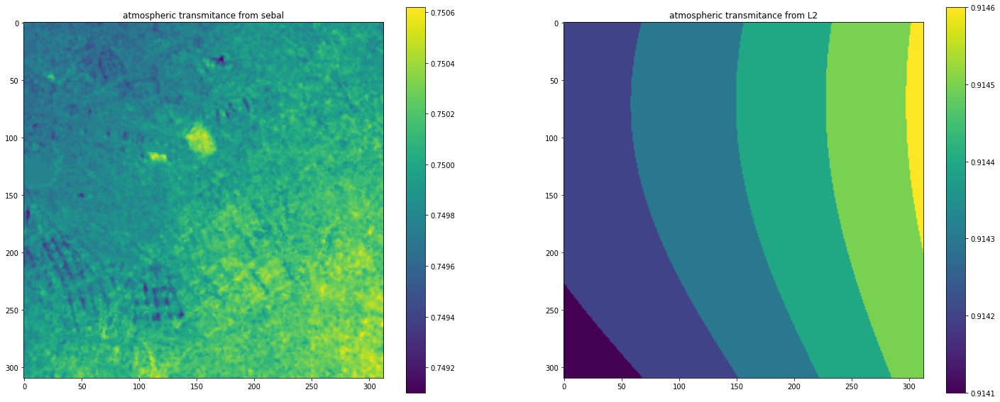

In [ ]:
fig, ax = plt.subplots(1, 2)


im = ax[0].imshow(taw)
ax[0].set_title('atmospheric transmitance from sebal')
plt.colorbar(im, ax=ax[0])

im = ax[1].imshow(atran)
ax[1].set_title('atmospheric transmitance from L2')
plt.colorbar(im, ax=ax[1])


plt.show()

## Upwelled radation

in sebal RL↑ units are `[w/m2]` but the L2 product urad unit is `[W/(m2.sr.μm)/DN]`
I dont know what is `per DN` but to remove the `per stradian` we can multiply by `4pi` (a whole sphere - or maybe 2pi for half sphere?)

and for `per micormeter` we can multiply by our thermal band band width (I dont know wheter to only choose band 10 or 11)

still with all this multiplication I don't think we can get the same values as Level2 (surface) upwell radiance.

this need to be investigated further.

In [ ]:
l2urad_dn = rasterio.open('/content/subset/L2/LC08__L2_urad_cliped.tif')
l2urad_dn =l2urad_dn.read()
l2urad_dn = l2urad_dn[0]

In [ ]:
urad = l2urad_dn * 0.001

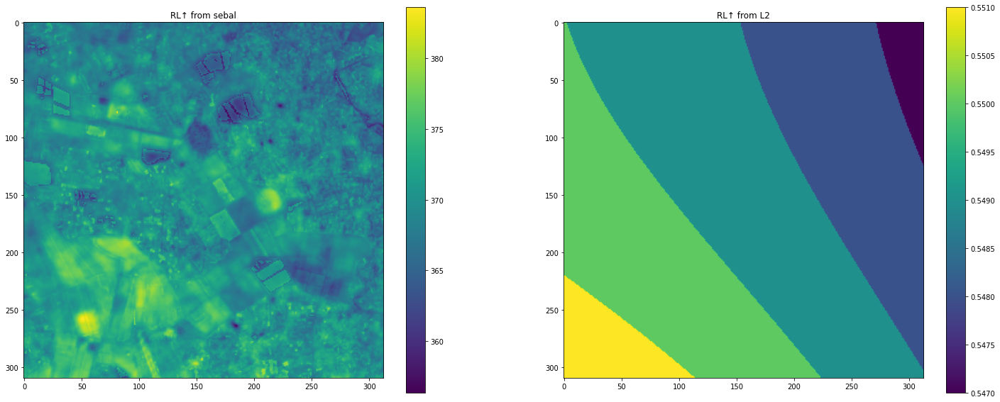

In [ ]:
fig, ax = plt.subplots(1, 2)


im = ax[0].imshow(r_long_up)
ax[0].set_title('RL↑ from sebal')
plt.colorbar(im, ax=ax[0])

im = ax[1].imshow(urad)
ax[1].set_title('RL↑ from L2')
plt.colorbar(im, ax=ax[1])


plt.show()